In [1]:
from sklearn.datasets import fetch_lfw_people
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

people.image.shape:(2537, 87, 65)
Number of classes:45
Alejandro Toledo           39 Alvaro Uribe               35 Amelie Mauresmo            21 
Andre Agassi               36 Ariel Sharon               77 Atal Bihari Vajpayee       24 
Bill Clinton               29 Colin Powell              236 David Beckham              31 
Donald Rumsfeld           121 George Robertson           22 George W Bush             530 
Gerhard Schroeder         109 Gloria Macapagal Arroyo    44 Gray Davis                 26 
Hamid Karzai               22 Hans Blix                  39 Hugo Chavez                71 
Igor Ivanov                20 Jack Straw                 28 Jacques Chirac             52 
Jean Chretien              55 Jennifer Aniston           21 Jennifer Capriati          42 
Jennifer Lopez             21 John Ashcroft              53 Juan Carlos Ferrero        28 
Junichiro Koizumi          60 Kofi Annan                 32 Laura Bush                 41 
Lindsay Davenport          22 Lleyt

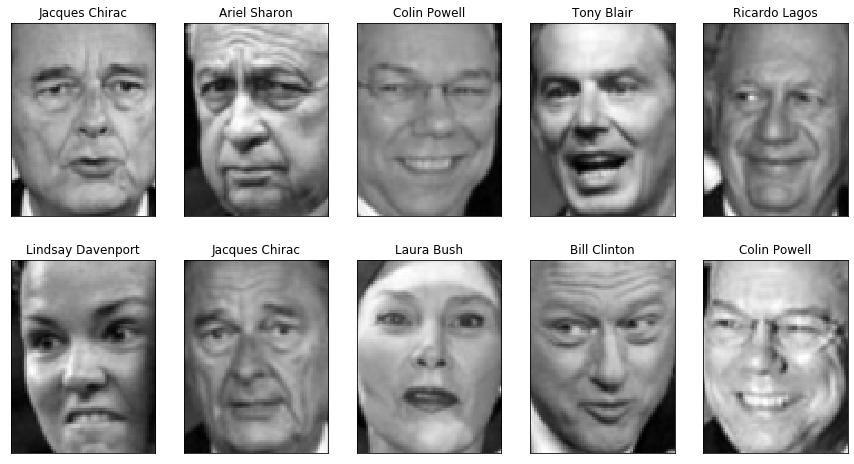

In [2]:
people = fetch_lfw_people(min_faces_per_person = 20, resize=0.7)
image_shape = people.images[0].shape
fig,axes = plt.subplots(2,5,figsize=(15,8),subplot_kw={'xticks':(),'yticks':()})

for target, image, ax in zip(people.target, people.images,axes.ravel()):
    ax.imshow(image, cmap=cm.gray)
    ax.set_title(people.target_names[target])

print("people.image.shape:{}".format(people.images.shape))
print("Number of classes:{}".format(len(people.target_names)))

counts = np.bincount(people.target)
for i, (count,name) in enumerate(zip(counts,people.target_names)):
    print('{0:25} {1:3}'.format(name,count), end =' ')
    if (i+1)%3 == 0:
        print()

In [3]:
mask = np.zeros(people.target.shape, dtype=np.bool)
for target in np.unique(people.target) :
    mask[np.where(people.target == target)[0][:50]] = 1
X_people = people.data[mask]
y_people = people.target[mask]
# scale the grayscale values to be between 0 and 1
# instead of 0 and 255 for better numeric stability
X_people = X_people / 255.

In [4]:
def standardise(X_train):
    mean = np.mean(X_train, axis=0)
    scale = np.std(X_train, axis=0, ddof=1)
    X_std = (X_train - mean) / scale
    return X_std

def unstandardize(x_train, x_un):
    mean = np.mean(x_train, axis=0)
    scale = np.std(x_train, axis=0, ddof=1)
    x_un = scale * x_un + mean
    return x_un

def Eigen(c_mat, d):
    e_vals, e_vecs = np.linalg.eig(c_mat)
    e_vals2 = e_vals.argsort()[-d:]
    val = e_vals[e_vals2[::-1]]
    e_vecs2 = e_vecs[:, e_vals2[::-1]]
    return val, e_vecs2

def PCA(e_vec2,X_std):
    xtr_dim = [X_std @ e_vec2[:,i] for i in range(e_vec2.shape[1])]
    xtr_dim = np.array(xtr_dim).T
    return xtr_dim

def E_L2(x,y):
    return np.sqrt(np.sum((x-y)**2,axis=1))


# def ED_L2(x1, x2):  # it is used for calculating euclidean distance
#     vector = (x1 - x2) ** 2
#     sm = np.sum(vector)
#     return np.sqrt(sm)

In [5]:
def clusterpoints(xtr_dim, centroid, k):

    clust_list = []
    for i in range(k):
        clust_list.append([])

    for datapoint in xtr_dim:
        distance = E_L2(centroid, datapoint)

        clust_list[distance.argmin()].append(datapoint)
    print(clust_list)
    return clust_list

def reconstruct(x, e_vecs2, x_train):
    fig = (x @ e_vecs2.T)
    fig = unstandardize(x_train, fig)
    fig = fig.reshape((87, 65))
    return fig.astype(float)

In [6]:
def K_mean(xtr_dim, k):
    index_count = 0
    indices = list(range(len(xtr_dim)))
    np.random.shuffle(indices)
    centroid = xtr_dim[indices[:k]]
    old_centroid = centroid.copy()
    convergence_test = False
    while convergence_test == False:
        clusters = clusterpoints(xtr_dim, centroid, k)
        new_centroid = centroid.copy()
        for i in range(len(centroid)):
            new_centroid[i] = np.array(clusters[i]).mean(axis=0)
        centroid = new_centroid
        unique_cent = np.abs(old_centroid - centroid)
        old_centroid = centroid.copy()
        index_count += 1
        if unique_cent.sum() < 2 ** (-23):
            convergence_test = True
        if index_count >= 10000:
            convergence_test = True
    return centroid,clusters, index_count

In [7]:
X_train, X_test, y_train, y_test = train_test_split(X_people, y_people, stratify=y_people, random_state=0)

X_std = standardise(X_train)
c_mat = X_std.T @ X_std
d = 100
e_vals, e_vecs = Eigen(c_mat,d)
xtr_dim = PCA(e_vecs,X_std)

#np.random.seed(0)
#clusters, centroid, iterations = K_mean(xtr_dim, 10)
#print(iterations)
#print(iterations)


In [8]:
np.random.seed(0)
centroid, all_clusters, index_count = K_mean(xtr_dim, 10)
print(index_count)

# for i, each in enumerate(clusters):
#     print(f'culster{i + 1}: {len(each)}')


[[array([ 2.4829483e-01, -2.8247164e+01,  1.1691647e+01,  1.4283172e+01,
       -2.1152218e+01,  1.6943542e+01,  1.4771262e-01,  8.5238752e+00,
        9.8562193e+00,  1.5750027e+01, -9.6181479e+00, -1.9833967e+01,
        1.0847403e+01, -3.8376508e+00, -2.1210656e+00, -4.3443003e+00,
       -6.5375006e-01, -8.3353806e+00, -1.1468649e+00, -2.8557522e+00,
       -1.2487196e+00, -5.3730927e+00, -4.0410140e-01, -2.3003659e+00,
        7.0855188e-01, -8.1820850e+00,  2.4184830e+00,  2.8527293e+00,
       -4.9248896e+00,  1.3469820e+00,  5.7948942e+00,  8.3987862e-01,
       -4.6513200e+00,  4.4203949e+00,  4.0830822e+00, -7.4327588e+00,
        7.8744411e+00,  6.0935819e-01,  1.0880713e+00,  2.7450392e+00,
       -1.7944126e+00,  3.4546642e+00, -4.3733296e+00,  1.4856186e+00,
       -4.4293079e+00, -6.6937551e+00,  1.7427002e+00,  3.3699892e+00,
        2.5393858e+00,  1.9784218e+00, -1.0491347e+00,  2.6838213e-01,
        9.5369968e+00, -4.8231311e+00, -1.0821255e+00, -2.0998931e+00,
    

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([ 2.4829483e-01, -2.8247164e+01,  1.1691647e+01,  1.4283172e+01,
       -2.1152218e+01,  1.6943542e+01,  1.4771262e-01,  8.5238752e+00,
        9.8562193e+00,  1.5750027e+01, -9.6181479e+00, -1.9833967e+01,
        1.0847403e+01, -3.8376508e+00, -2.1210656e+00, -4.3443003e+00,
       -6.5375006e-01, -8.3353806e+00, -1.1468649e+00, -2.8557522e+00,
       -1.2487196e+00, -5.3730927e+00, -4.0410140e-01, -2.3003659e+00,
        7.0855188e-01, -8.1820850e+00,  2.4184830e+00,  2.8527293e+00,
       -4.9248896e+00,  1.3469820e+00,  5.7948942e+00,  8.3987862e-01,
       -4.6513200e+00,  4.4203949e+00,  4.0830822e+00, -7.4327588e+00,
        7.8744411e+00,  6.0935819e-01,  1.0880713e+00,  2.7450392e+00,
       -1.7944126e+00,  3.4546642e+00, -4.3733296e+00,  1.4856186e+00,
       -4.4293079e+00, -6.6937551e+00,  1.7427002e+00,  3.3699892e+00,
        2.5393858e+00,  1.9784218e+00, -1.0491347e+00,  2.6838213e-01,
        9.5369968e+00, -4.8231311e+00, -1.0821255e+00, -2.0998931e+00,
    

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([-23.77874   ,  -5.3645983 ,   3.383924  ,  24.786724  ,
        -4.594206  , -11.888474  ,  -2.9763274 ,   1.7289107 ,
         0.5272794 ,   4.7684298 ,   5.784177  ,  14.975538  ,
         2.8297012 ,  -8.630793  ,  -5.747014  ,  -0.50434816,
        10.154602  ,  -3.2613573 ,  10.644589  ,   3.8570557 ,
         2.3544827 ,   6.4970512 ,  -7.9556913 ,  -4.086261  ,
        -1.5786211 ,   0.07344581,  -0.7176025 ,  -0.03346153,
        -1.5838966 ,   6.5946245 ,  -3.7860446 ,   4.6149116 ,
         7.155265  ,  -4.159666  ,   8.15836   ,   7.9417706 ,
         3.7666686 ,  -9.177387  ,   1.4295853 ,   0.58600205,
         5.137391  ,  -3.8611183 ,  -7.428067  ,  -4.8162317 ,
        -2.885922  ,  -1.3176141 ,  -4.608959  ,  -2.8347802 ,
         2.2502317 ,  -0.871387  ,  -3.0297832 ,  -6.57081   ,
        -3.6925826 ,   4.8487816 ,   2.2957594 ,  -1.3709173 ,
         5.202244  ,   7.0856876 ,  -2.8880918 ,  -2.1190453 ,
        -2.5583415 ,  -1.8518808 ,  -2.9526498 ,  -0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([ -5.8572407 ,   2.3571138 ,  -7.8124924 ,   4.08849   ,
        31.893478  ,   2.5661945 ,  -8.436508  ,  -0.2125609 ,
         1.8754487 ,  -1.1357465 ,  -4.538107  ,   9.578281  ,
         9.891144  , -10.295689  ,  10.533531  ,   3.003656  ,
        -1.5124085 ,  -1.4260354 ,  -1.0784631 ,   2.6813772 ,
        11.19463   ,  -4.162232  ,   1.1676847 ,   1.7365459 ,
        12.370394  ,   2.113548  ,   1.1181488 ,  -0.3326401 ,
         4.808679  ,   3.1200805 ,  -7.0213127 ,   3.360346  ,
         1.1675377 ,  -1.302937  ,  -0.96091586,  -1.7129376 ,
        -2.8414884 ,   1.5469397 ,   0.5780478 ,  -0.5574778 ,
         0.5493914 ,  -1.3715472 ,  -2.8156934 ,   2.6587749 ,
        -4.666029  ,  -4.4970694 ,   1.9736636 ,   1.2672536 ,
        -4.393227  ,   1.7668118 ,  -2.038152  ,   1.7417479 ,
         2.4446557 ,  -0.5094929 ,  -0.7673614 ,  -2.4318113 ,
        -7.809583  ,  -0.10637039,   4.1948833 ,  -2.8327527 ,
         3.510592  ,   1.4140632 ,   2.934797  ,  -0.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([  4.0976677 ,  24.259317  ,   4.0056515 , -14.987681  ,
         7.0232916 ,   3.7343366 ,  -2.650819  ,   3.0830648 ,
         2.4972744 ,  -0.37929365,  -3.6296144 ,   4.1723495 ,
         2.4191294 ,   3.4682178 ,   3.8890126 ,  -2.1539412 ,
         4.377039  ,  -4.245186  ,   2.198306  ,   2.0599709 ,
         3.076882  ,   3.2287972 ,  -4.8381987 ,  -4.8888927 ,
        -6.2935047 ,   1.493415  ,  -3.6596851 ,   1.6672633 ,
         0.38446677,   2.7896442 ,   1.4853584 ,   0.49053   ,
         0.61393183,   0.62925804,  -3.5937624 ,   8.675025  ,
         3.1299794 ,   2.146247  ,  -0.04561701,  -5.14394   ,
        -1.6489387 ,   0.4587169 ,  -0.64217997,  -2.1874747 ,
         0.09800072,   2.1950977 ,   1.4669327 ,  -2.3027568 ,
         2.446834  ,   0.09814703,   3.6000614 ,  -2.3983302 ,
        -0.5433458 ,   4.775278  ,  -1.9157921 ,  -1.537331  ,
         0.6742769 ,  -2.2667024 ,  -0.1548586 ,  -2.8881893 ,
         2.1811333 ,  -2.1937246 ,   1.6481056 ,   1.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([  4.0976677 ,  24.259317  ,   4.0056515 , -14.987681  ,
         7.0232916 ,   3.7343366 ,  -2.650819  ,   3.0830648 ,
         2.4972744 ,  -0.37929365,  -3.6296144 ,   4.1723495 ,
         2.4191294 ,   3.4682178 ,   3.8890126 ,  -2.1539412 ,
         4.377039  ,  -4.245186  ,   2.198306  ,   2.0599709 ,
         3.076882  ,   3.2287972 ,  -4.8381987 ,  -4.8888927 ,
        -6.2935047 ,   1.493415  ,  -3.6596851 ,   1.6672633 ,
         0.38446677,   2.7896442 ,   1.4853584 ,   0.49053   ,
         0.61393183,   0.62925804,  -3.5937624 ,   8.675025  ,
         3.1299794 ,   2.146247  ,  -0.04561701,  -5.14394   ,
        -1.6489387 ,   0.4587169 ,  -0.64217997,  -2.1874747 ,
         0.09800072,   2.1950977 ,   1.4669327 ,  -2.3027568 ,
         2.446834  ,   0.09814703,   3.6000614 ,  -2.3983302 ,
        -0.5433458 ,   4.775278  ,  -1.9157921 ,  -1.537331  ,
         0.6742769 ,  -2.2667024 ,  -0.1548586 ,  -2.8881893 ,
         2.1811333 ,  -2.1937246 ,   1.6481056 ,   1.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([  4.0976677 ,  24.259317  ,   4.0056515 , -14.987681  ,
         7.0232916 ,   3.7343366 ,  -2.650819  ,   3.0830648 ,
         2.4972744 ,  -0.37929365,  -3.6296144 ,   4.1723495 ,
         2.4191294 ,   3.4682178 ,   3.8890126 ,  -2.1539412 ,
         4.377039  ,  -4.245186  ,   2.198306  ,   2.0599709 ,
         3.076882  ,   3.2287972 ,  -4.8381987 ,  -4.8888927 ,
        -6.2935047 ,   1.493415  ,  -3.6596851 ,   1.6672633 ,
         0.38446677,   2.7896442 ,   1.4853584 ,   0.49053   ,
         0.61393183,   0.62925804,  -3.5937624 ,   8.675025  ,
         3.1299794 ,   2.146247  ,  -0.04561701,  -5.14394   ,
        -1.6489387 ,   0.4587169 ,  -0.64217997,  -2.1874747 ,
         0.09800072,   2.1950977 ,   1.4669327 ,  -2.3027568 ,
         2.446834  ,   0.09814703,   3.6000614 ,  -2.3983302 ,
        -0.5433458 ,   4.775278  ,  -1.9157921 ,  -1.537331  ,
         0.6742769 ,  -2.2667024 ,  -0.1548586 ,  -2.8881893 ,
         2.1811333 ,  -2.1937246 ,   1.6481056 ,   1.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([  4.0976677 ,  24.259317  ,   4.0056515 , -14.987681  ,
         7.0232916 ,   3.7343366 ,  -2.650819  ,   3.0830648 ,
         2.4972744 ,  -0.37929365,  -3.6296144 ,   4.1723495 ,
         2.4191294 ,   3.4682178 ,   3.8890126 ,  -2.1539412 ,
         4.377039  ,  -4.245186  ,   2.198306  ,   2.0599709 ,
         3.076882  ,   3.2287972 ,  -4.8381987 ,  -4.8888927 ,
        -6.2935047 ,   1.493415  ,  -3.6596851 ,   1.6672633 ,
         0.38446677,   2.7896442 ,   1.4853584 ,   0.49053   ,
         0.61393183,   0.62925804,  -3.5937624 ,   8.675025  ,
         3.1299794 ,   2.146247  ,  -0.04561701,  -5.14394   ,
        -1.6489387 ,   0.4587169 ,  -0.64217997,  -2.1874747 ,
         0.09800072,   2.1950977 ,   1.4669327 ,  -2.3027568 ,
         2.446834  ,   0.09814703,   3.6000614 ,  -2.3983302 ,
        -0.5433458 ,   4.775278  ,  -1.9157921 ,  -1.537331  ,
         0.6742769 ,  -2.2667024 ,  -0.1548586 ,  -2.8881893 ,
         2.1811333 ,  -2.1937246 ,   1.6481056 ,   1.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[array([  4.0976677 ,  24.259317  ,   4.0056515 , -14.987681  ,
         7.0232916 ,   3.7343366 ,  -2.650819  ,   3.0830648 ,
         2.4972744 ,  -0.37929365,  -3.6296144 ,   4.1723495 ,
         2.4191294 ,   3.4682178 ,   3.8890126 ,  -2.1539412 ,
         4.377039  ,  -4.245186  ,   2.198306  ,   2.0599709 ,
         3.076882  ,   3.2287972 ,  -4.8381987 ,  -4.8888927 ,
        -6.2935047 ,   1.493415  ,  -3.6596851 ,   1.6672633 ,
         0.38446677,   2.7896442 ,   1.4853584 ,   0.49053   ,
         0.61393183,   0.62925804,  -3.5937624 ,   8.675025  ,
         3.1299794 ,   2.146247  ,  -0.04561701,  -5.14394   ,
        -1.6489387 ,   0.4587169 ,  -0.64217997,  -2.1874747 ,
         0.09800072,   2.1950977 ,   1.4669327 ,  -2.3027568 ,
         2.446834  ,   0.09814703,   3.6000614 ,  -2.3983302 ,
        -0.5433458 ,   4.775278  ,  -1.9157921 ,  -1.537331  ,
         0.6742769 ,  -2.2667024 ,  -0.1548586 ,  -2.8881893 ,
         2.1811333 ,  -2.1937246 ,   1.6481056 ,   1.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [26]:
for i, e in enumerate(all_clusters):
    print(f'cluster{i + 1}: {len(e)}')

cluster1: 213
cluster2: 117
cluster3: 70
cluster4: 128
cluster5: 148
cluster6: 134
cluster7: 129
cluster8: 112
cluster9: 64
cluster10: 67


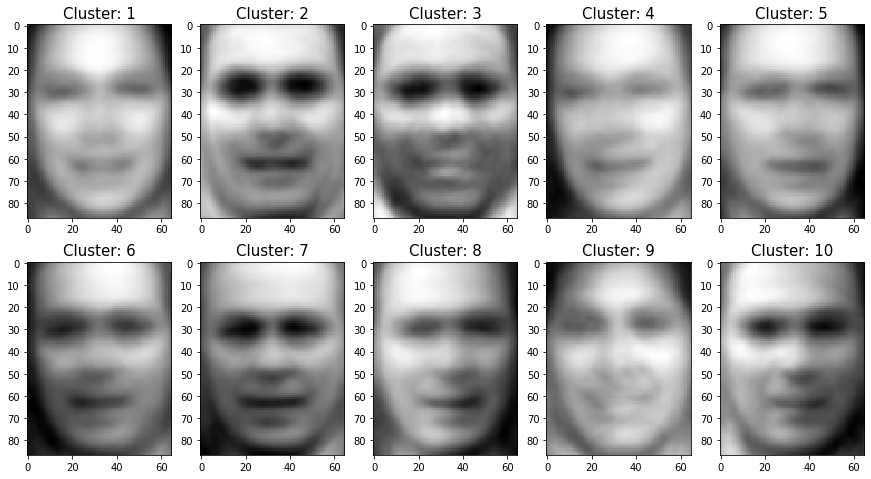

In [10]:
figure, xy_axis = plt.subplots(2, 5, figsize=(15, 8))

for i, x, n in zip(range(len(centroid)), centroid, xy_axis.ravel()):
    title = f'Cluster: {i + 1}'
    fig = reconstruct(x, e_vecs, X_train)
    n.imshow(fig, cmap=cm.gray)
    n.set_title(title, fontsize=15)


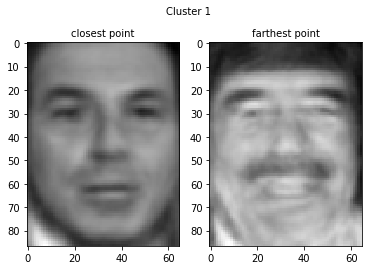

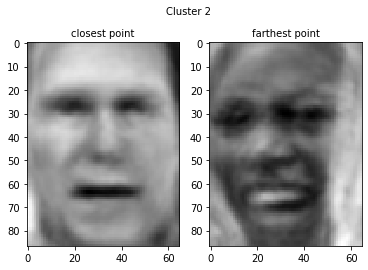

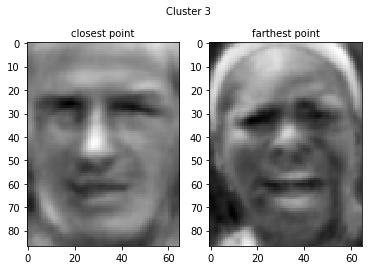

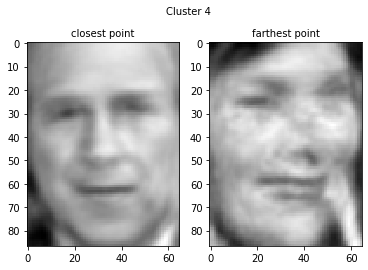

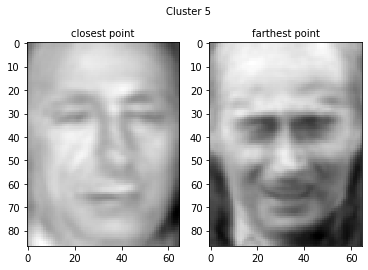

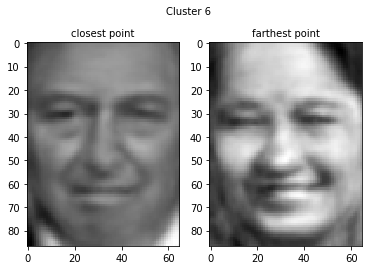

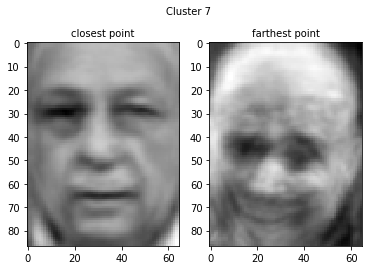

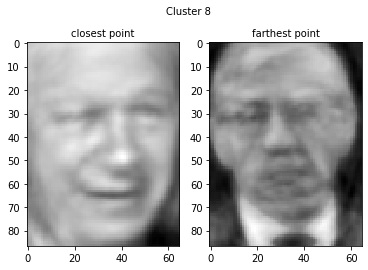

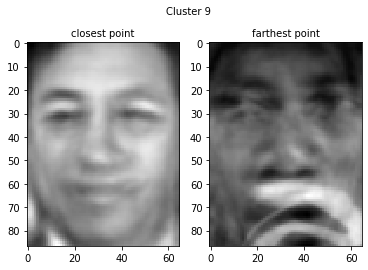

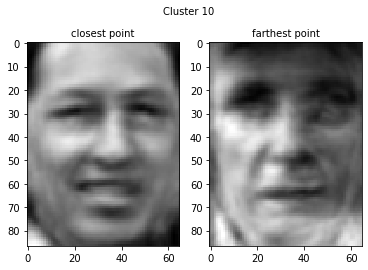

In [25]:
#print(fig_image_recon)
fig_image_recon = []
for cen, clust_list in zip(centroid, all_clusters):
    recon1 = reconstruct(clust_list[np.argmin(E_L2(cen, clust_list))], e_vecs, X_train)
    recon2 = reconstruct(clust_list[np.argmax(E_L2(cen, clust_list))], e_vecs, X_train)
    fig_image_recon1 = [recon1,recon2]
    fig_image_recon.append(fig_image_recon1)

for i, f in enumerate(fig_image_recon):
    figure, xy_axis = plt.subplots(1, 2)
    figure.suptitle(f'Cluster {i + 1}', fontsize=10)
    xy_axis[0].imshow(f[0], cmap=cm.gray)
    xy_axis[0].set_title('closest point', fontsize=10)
    xy_axis[1].imshow(f[1], cmap=cm.gray)
    xy_axis[1].set_title('farthest point', fontsize=10)

In [12]:
indices2 = list(range(xtr_dim.shape[0]))
np.random.seed(0)
np.random.shuffle(indices2)
indices2[:10]

[817, 351, 704, 434, 513, 703, 1121, 813, 362, 644]

In [13]:
c1 = all_clusters[0].copy()

all_clusters[0][np.argmax(E_L2(all_clusters[0], centroid[0]))]

array([-1.3977457e+01, -1.2758650e+01,  9.1980042e+01, -3.2220268e+01,
        1.6837729e+01,  1.1850398e+00, -7.8455284e-03,  1.0780804e+01,
       -1.2505817e+01, -1.1738381e+01,  1.9618261e+01,  4.9012656e+00,
       -1.2100197e+01, -5.1752386e+00, -3.0431633e+00,  1.7349636e+01,
       -2.5568026e-01, -1.1817688e+01, -1.5644290e+00, -1.1746781e+00,
        6.7944908e+00, -4.0457435e+00,  9.5293560e+00,  1.3068090e+01,
       -1.9050106e+01,  3.0766625e+00, -1.3703382e+01,  8.9447727e+00,
        5.1283388e+00, -6.0594969e+00,  5.3571978e+00,  1.1167551e+00,
       -1.5895322e+01,  2.3941243e+00,  4.1431398e+00,  6.3618364e+00,
       -3.7016058e-01, -5.1181698e+00,  8.0670280e+00, -1.1824276e+01,
       -5.0949955e+00,  8.6378403e+00,  9.2176142e+00, -2.1778669e+00,
       -4.9680052e+00,  1.5333388e+00,  8.6819735e+00, -5.6191921e+00,
       -1.8246973e+00, -8.7523866e-01,  7.7305145e+00, -2.9344587e+00,
       -3.2990053e+00, -7.8658209e+00, -6.7355728e-01,  3.2829916e+00,
      